#                                Housing Prices Database Management

Abstract :

The aim of this project work on the collected data which is has gone through regression and exploratory data analysis to get an insight of the housing prices with respect to its other attributes. This data has been used to create stored procedures, views, indexes, functions and use cases. We have also created ER diagram and conceptual schema to represent the data and to show the relationships between the tables. All the tables used here are normalized to reduce redundancies and dependancies. 

Data Source Explanation:

The hyperparameter database is a public resource with algorithms, tools, and data that allows users to visualize and understand how to choose hyperparameters that maximizes the predictive power of their models. The hyperparameter database is created by running millions of hyperparameter values, over thousands of public datasets and calculating the individual conditional expectation of every hyperparameter on the quality of a model.
The dataset being used here is Housing Price Dataset:
Housing prices dataset consists of attributes on which the price of the house depends. The dataset includes prices for 50000 houses and other columns taken into consideration will be factors which might affect the prices.
The attributes included here are Area, Garage, FirePlace, Baths, White Marble, Black Marble, Indian Marble, Floors, City, Solar, Electric, Fiber, Glass Doors, Swimming Pool, Garden and Prices.

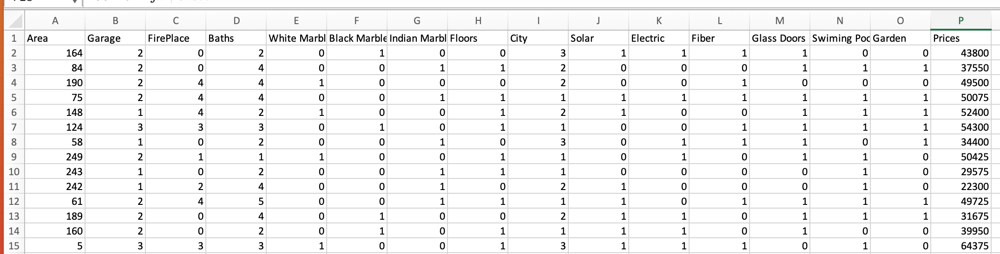

Entity Relationship:

    An entity relationship diagram (ERD), also known as an entity relationship model, is a graphical representation of an information system that depicts the relationships among people, objects, places, concepts or events within that system. An ERD is a data modeling echnique that can help define business processes and be used as the foundation for a relational database.
    Our ER diagram has the following entities :
    
    DataSet Table
    Data Description Table
    Data_Distribution Table
    Model Table
    Model meta data table
    DRF_Hyperparameter Table
    Model_Metrices Table
    variable importance table
    
    Our ER diagram has one to many connections with all its connections. The model table has one to many connections with model metrices, model meta data and hyperparameter table. This is because one model can have different meta data, hyperparameter and metrices. The data set table has is connected with model table, data distribution table and data description table with one to many relationship. This is because one data set can be used with many models,and the data set can be used with different combinations of split data and percentages of split. The hyperparameter table is connected with hyperparameter values table with one to many relationship, and this is because each each hyperparameter can have different values for actual and default and it can vary for each run, with a different runtime. The model metrices table is connected with variable importance table with a one to many relationship as well.

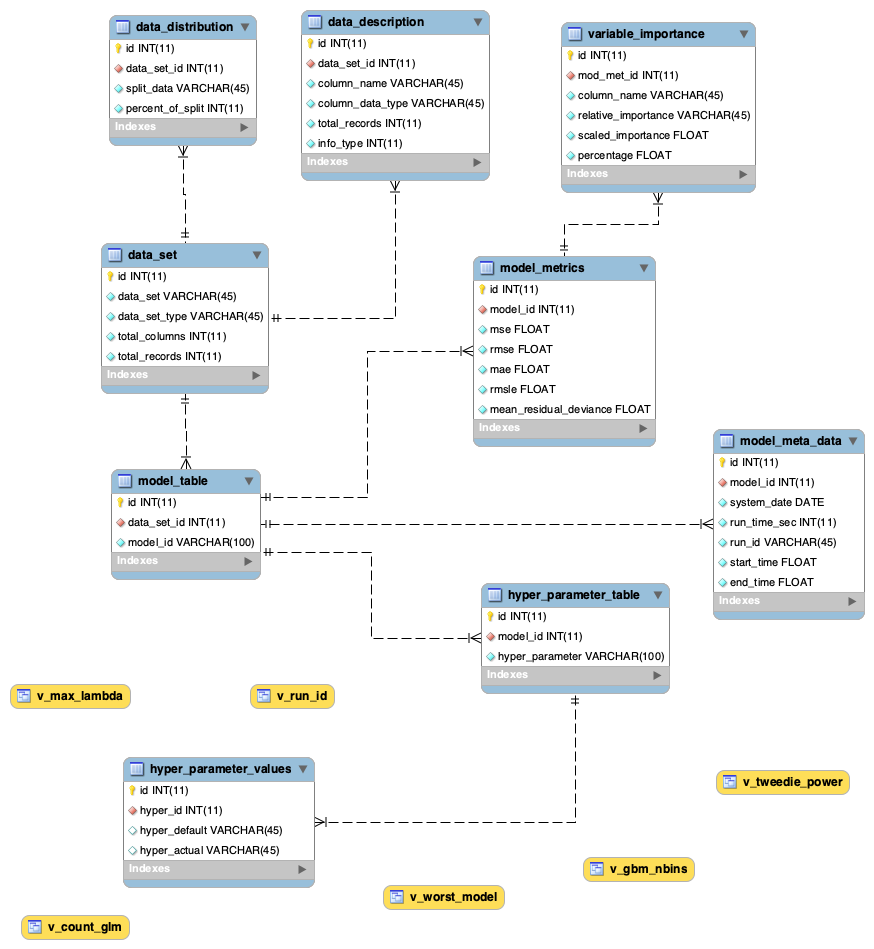

Conceptual Diagram:

    Conceptual design is the first stage in the database design process. The goal at this stage is to design a database that is independent of database software and physical details. The output of this process is a conceptual data model that describes the main data entities, attributes, relationships, and constraints of a given problem domain.
    The entities in the conceptual diagram is shown in rectangles and the attributes in ovals. The data set table has is connected with model table, data distribution table and data description table with one to many relationship. This is because one data set can be used with many models, and the data set can be used with different combinations of split data and percentages of split. The hyperparameter table is connected with hyperparameter values table with one to many relationship, and this is because each each hyperparameter can have different values for actual and default and it can vary for each run, with a different runtime. The model metrices table is connected with variable importance table with a one to many relationship as well. 
    The relationships here are shown with rhombuses in between two entities and all the relationships are shown as "Holds". This is because the each entity is holding values of other entities which also means one entity may be dependant on the other with primary-foriegn key relationships. The one-to-many relationship is representd using 1 and N, respectively on the connections of entities .



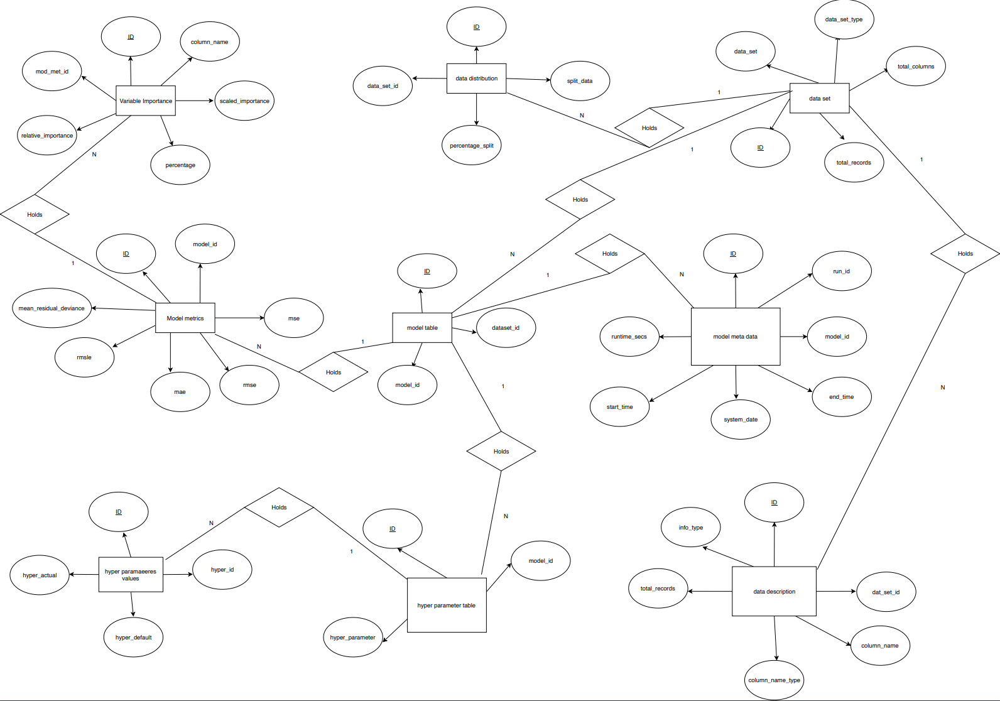

INSERT ANOMILITIES:

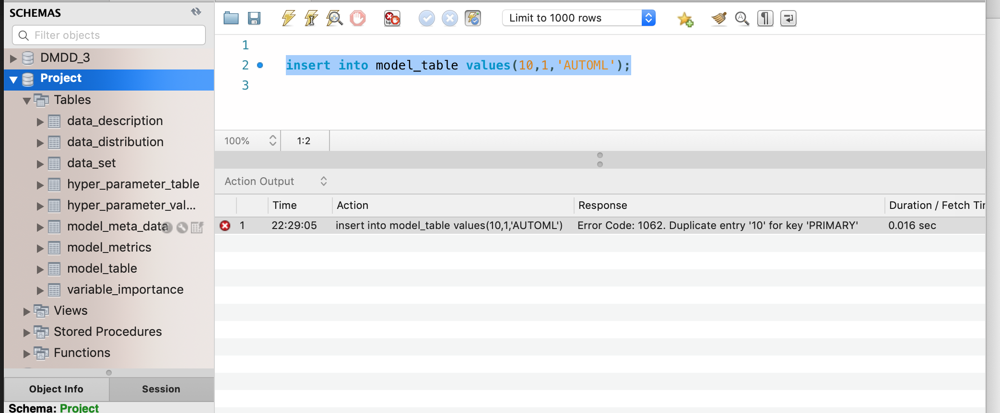

UPDATE ANOMILITIES:

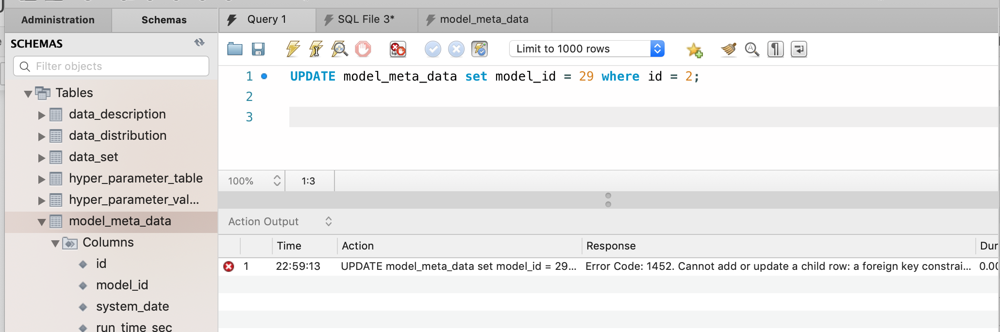

DELETE ANOMILITIES:

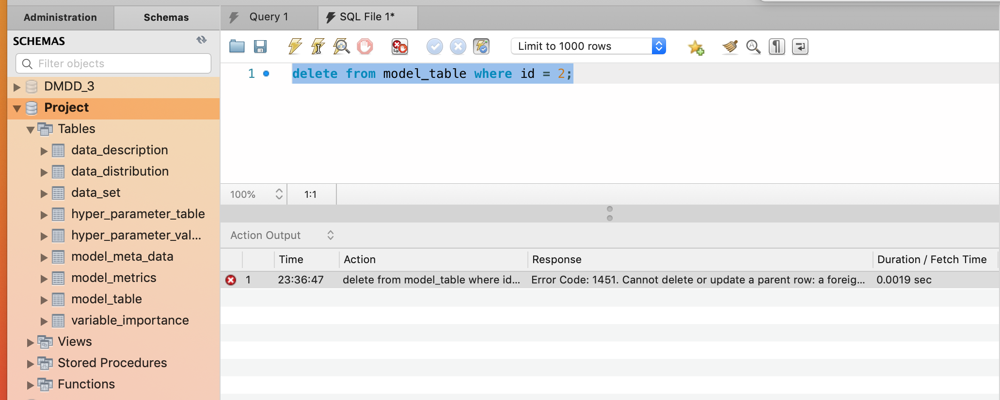

VIEWS:

1. List the model id, run time in seconds and the default and actual values for the hyper parameter nbins for the GBM algorithm for the run time 1000.

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_gbm_nbins` AS
    SELECT 
        `mt`.`model_id` AS `model_id`,
        `mm`.`run_time_sec` AS `run_time_sec`,
        `hp`.`hyper_parameter` AS `hyper_parameter`,
        `hpv`.`hyper_actual` AS `hyper_actual`,
        `hpv`.`hyper_default` AS `hyper_default`
    FROM
        (((`model_table` `mt`
        JOIN `model_meta_data` `mm` ON ((`mt`.`id` = `mm`.`model_id`)))
        JOIN `hyper_parameter_table` `hp` ON ((`mt`.`id` = `hp`.`model_id`)))
        JOIN `hyper_parameter_values` `hpv` ON ((`hp`.`id` = `hpv`.`hyper_id`)))
    WHERE
        ((`hp`.`hyper_parameter` = 'nbins')
            AND (`mm`.`run_time_sec` = 1000)
            AND (`mt`.`model_id` LIKE '%GBM%'))

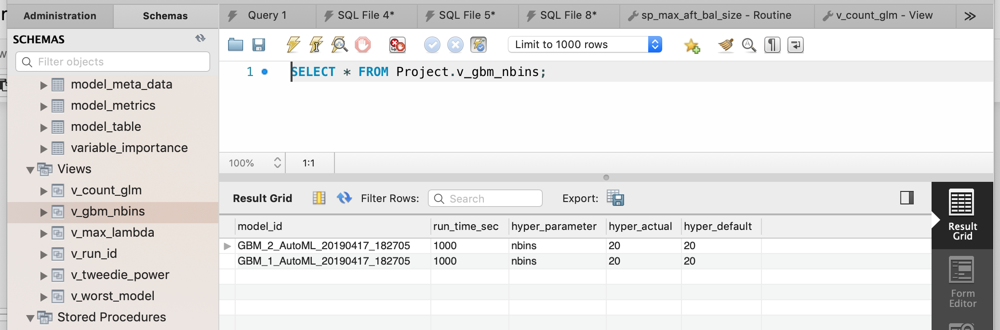

2. List the maximum value for the lambda hyperparameter for GLM algorithm.

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_max_lambda` AS
    SELECT 
        MAX(`hpv`.`hyper_actual`) AS `max_lambda`
    FROM
        (`hyper_parameter_values` `hpv`
        JOIN `hyper_parameter_table` `hp` ON ((`hpv`.`hyper_id` = `hp`.`id`)))
    WHERE
        (`hp`.`hyper_parameter` = 'lambda')

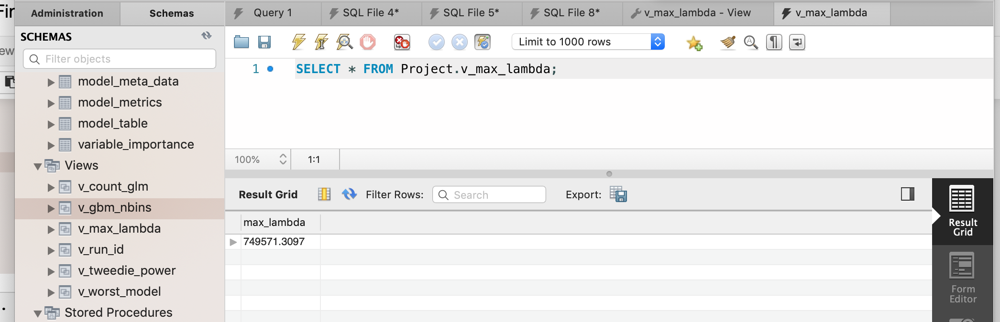

3. List all the model id along with its run time in seconds for the run id 6tGKlAAzz.

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_run_id` AS
    SELECT 
        `mt`.`model_id` AS `model_id`,
        `mm`.`run_time_sec` AS `run_time_sec`
    FROM
        (`model_table` `mt`
        JOIN `model_meta_data` `mm` ON ((`mt`.`id` = `mm`.`model_id`)))
    WHERE
        (`mm`.`run_id` = '6tGKlAAzz')

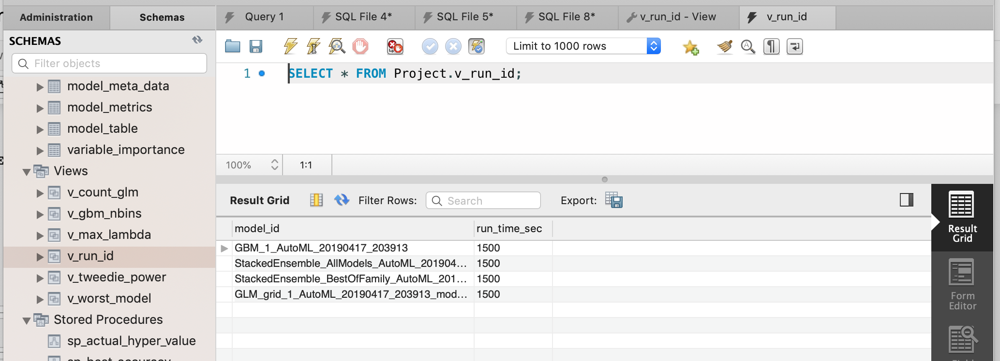

4. List the model id and run time in seconds for the hyper parameter tweedie_power with actual value as 1.5 for the GBM algorithm.

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_tweedie_power` AS
    SELECT 
        `mt`.`model_id` AS `model_id`,
        `mm`.`run_time_sec` AS `run_time_sec`,
        `hp`.`hyper_parameter` AS `hyper_parameter`,
        `hpv`.`hyper_actual` AS `hyper_actual`
    FROM
        (((`model_table` `mt`
        JOIN `model_meta_data` `mm` ON ((`mt`.`id` = `mm`.`model_id`)))
        JOIN `hyper_parameter_table` `hp` ON ((`mt`.`id` = `hp`.`model_id`)))
        JOIN `hyper_parameter_values` `hpv` ON ((`hp`.`id` = `hpv`.`hyper_id`)))
    WHERE
        ((`hp`.`hyper_parameter` = 'tweedie_power')
            AND (`hpv`.`hyper_actual` = 1.5))

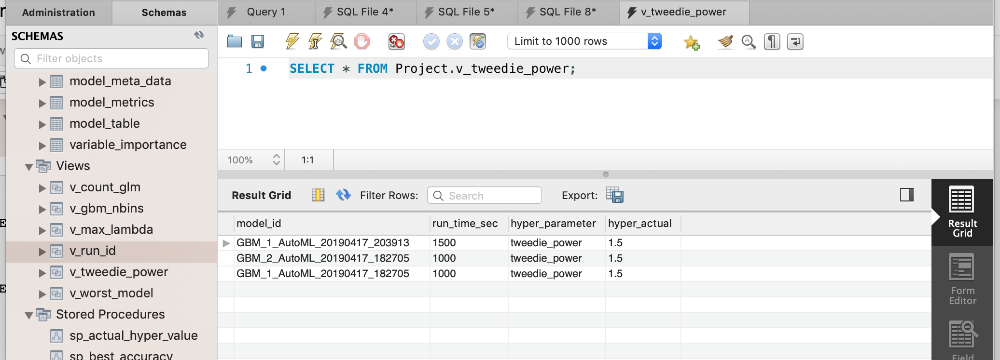

5. List the model id along with its run time in seconds with its model metrics data which has the accuracy is very low. 

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_worst_model` AS
    SELECT 
        `mt`.`model_id` AS `model_id`,
        `mmd`.`run_time_sec` AS `run_time_sec`,
        `mm`.`rmse` AS `rmse`,
        `mm`.`mse` AS `mse`,
        `mm`.`mae` AS `mae`,
        `mm`.`rmsle` AS `rmsle`
    FROM
        ((((`model_table` `mt`
        JOIN `model_meta_data` `mmd` ON ((`mt`.`id` = `mmd`.`model_id`)))
        JOIN `hyper_parameter_table` `hp` ON ((`mt`.`id` = `hp`.`model_id`)))
        JOIN `hyper_parameter_values` `hpv` ON ((`hp`.`id` = `hpv`.`hyper_id`)))
        JOIN `model_metrics` `mm` ON ((`mm`.`model_id` = `mt`.`id`)))
    WHERE
        (`mm`.`rmse` = (SELECT 
                MAX(`model_metrics`.`rmse`)
            FROM
                `model_metrics`))
    LIMIT 1

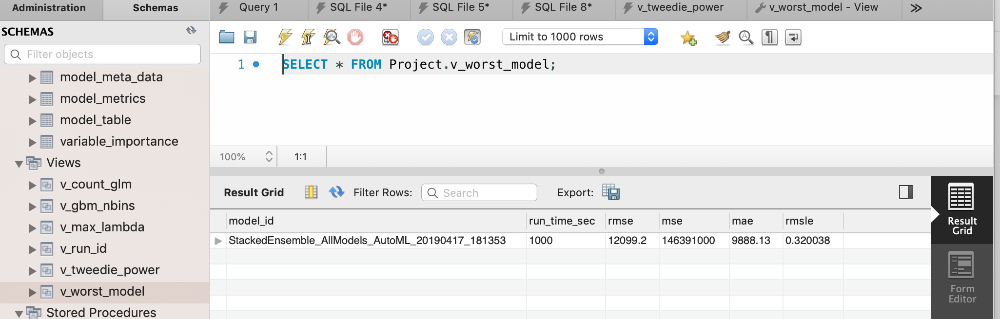

6. List the number of models generated for a particular algorithm "GLM". 

CREATE 
    ALGORITHM = UNDEFINED 
    DEFINER = `root`@`localhost` 
    SQL SECURITY DEFINER
VIEW `v_count_glm` AS
    SELECT 
        COUNT(`model_table`.`model_id`) AS `COUNT(model_id)`
    FROM
        `model_table`
    WHERE
        (`model_table`.`model_id` LIKE '%GLM%')

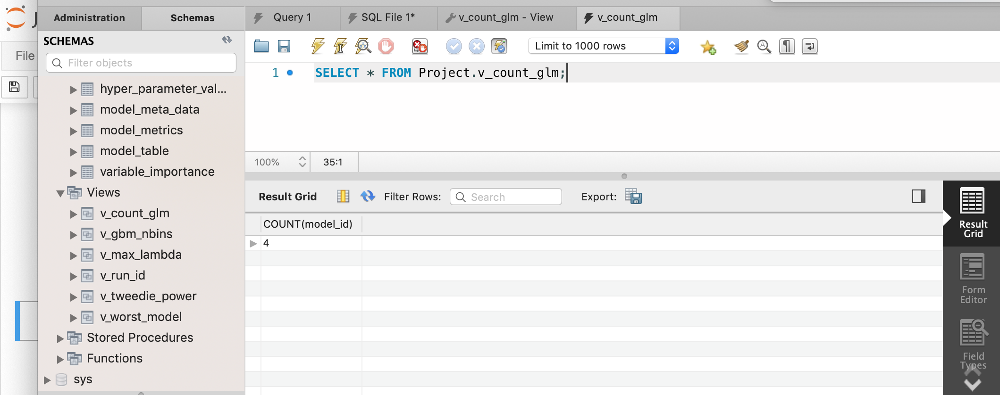

STORED PROCEDURE :

1. For any given hyper parameter for a run time in seconds 1500 list its model id along with its actual hyper parameter value.

    CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_actual_hyper_value`(IN hype varchar(50))
    BEGIN
    select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual from model_table mt inner join   
    model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
    mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
    WHERE hp.hyper_parameter = hype and mm.run_time_sec = 1500;
    END

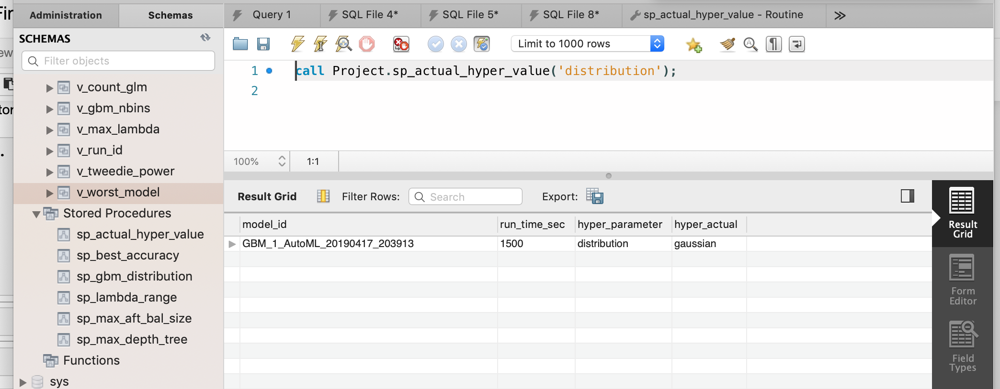

2. List the model with its model id with its run time in seconds which has best accuracy.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_best_accuracy`()
BEGIN
SELECT mt.model_id,mmd.run_time_sec,(SELECT MIN(rmse) from model_metrics) as best_accuracy
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id LIMIT 1;
END


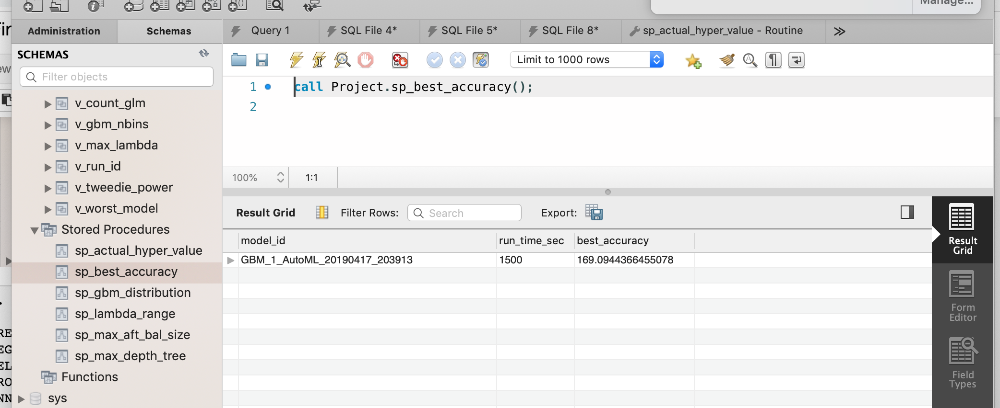

3. List the models along with its model id, run time in seconds for the hyper parameter distribution which has the actual hyper parameter value as distribution for GBM algorithm.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_gbm_distribution`()
BEGIN
select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "distribution" and hpv.hyper_actual = "gaussian";
END

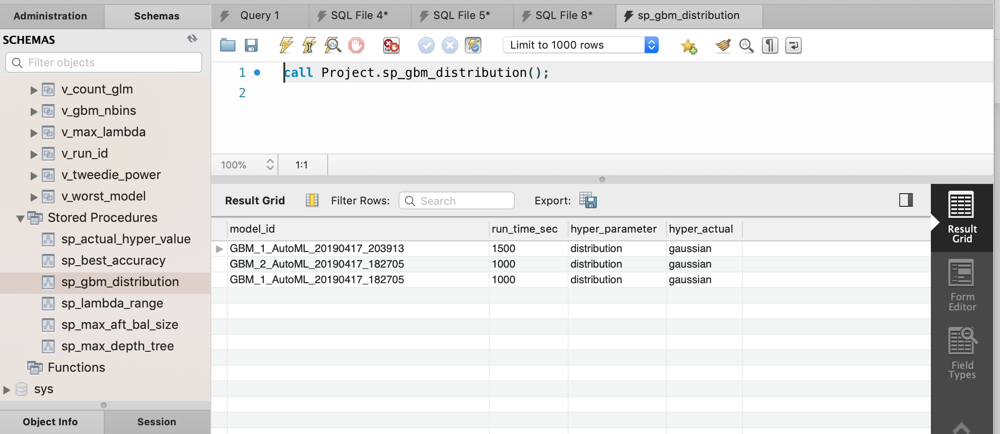

4. List the minimum alpha value, maximum alpha value and the range for the hyperparamter alpha for run time in seconds as 1000 and for the model GLM. 

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_lambda_range`()
BEGIN
select MIN(hpv.hyper_actual) as min_alpha,
MAX(hpv.hyper_actual) as max_alpha, 
(MAX(hpv.hyper_actual) - MIN(hpv.hyper_actual)) as alpha_range
from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter = 'lambda' AND 
mt.model_id like '%GLM%' and mm.run_time_sec = 1000;
END

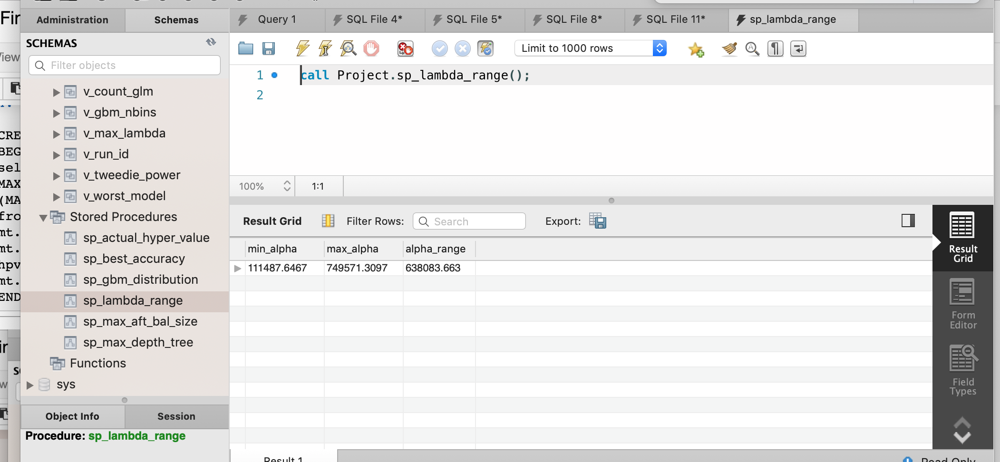

5. For any given run time in seconds list the model id for the hyperparameter max_depth along with its default and actual values for GBM algorithm.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_max_depth_tree`(IN seconds integer)
BEGIN
select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual,hpv.hyper_default from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "max_depth" and mm.run_time_sec = seconds and mt.model_id like "%GBM%";
END

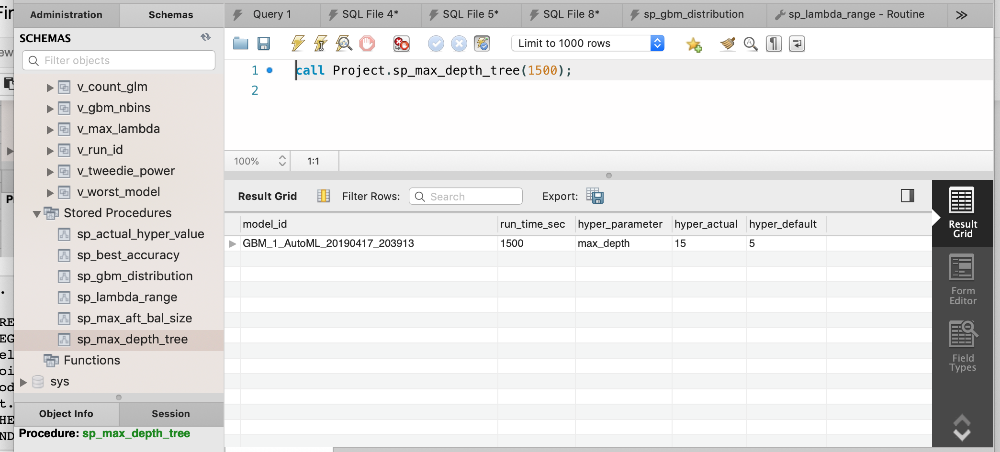

USE CASES:

1. What should be the default value for max_after_balance_size if the data frame size increases when dealing with unbalanced data.


SELECT mt.model_id,mm.run_time_sec,hpv.hyper_actual,hpv.hyper_default FROM model_table mt INNER JOIN 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "max_after_balance_size";

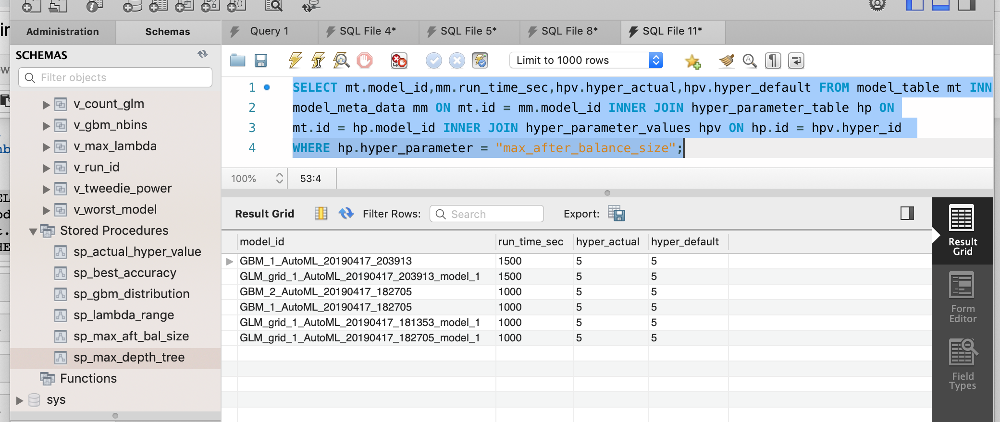

2.  List all the hyperparameters based on the model GLM for particular run time 1000.

SELECT mt.model_id, hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual FROM model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('seed','tweedie_link_power',
'alpha','lambda','standardize','missing_values_handling','max_iterations',
'balance_classes','max_after_balance_size','max_runtime_secs') AND 
mt.model_id like '%GLM%' and mm.run_time_sec = 1000;

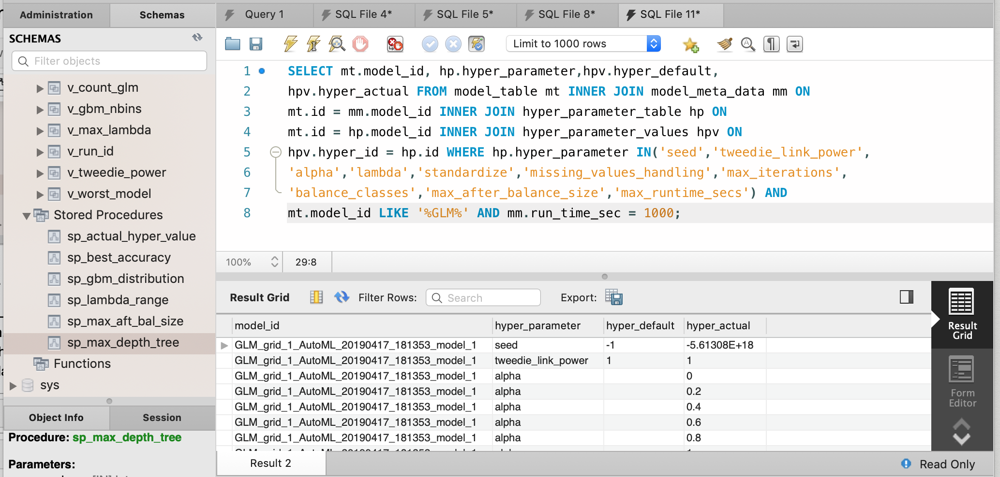

3.  List out the average error efficiency for a particular run time = 1500.


SELECT (SELECT AVG(rmse) from model_metrics) as average_accuracy
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id 
WHERE mmd.run_time_sec = 1500 LIMIT 1; 

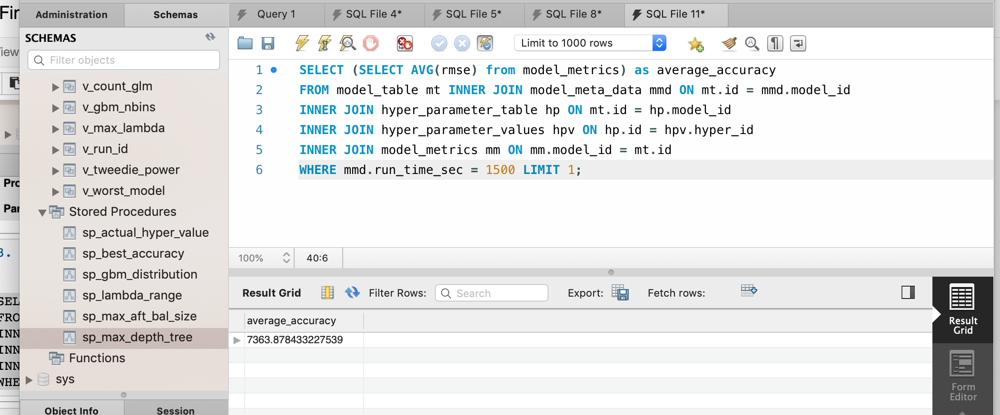

4.  Give the range of the hyperparameter alpha for GLM for run time 1000.

SELECT MIN(hpv.hyper_actual) AS min_alpha,
MAX(hpv.hyper_actual) AS max_alpha, 
(MAX(hpv.hyper_actual) - MIN(hpv.hyper_actual)) AS alpha_range
from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter = 'alpha' AND 
mt.model_id like '%GLM%' AND mm.run_time_sec = 1000;

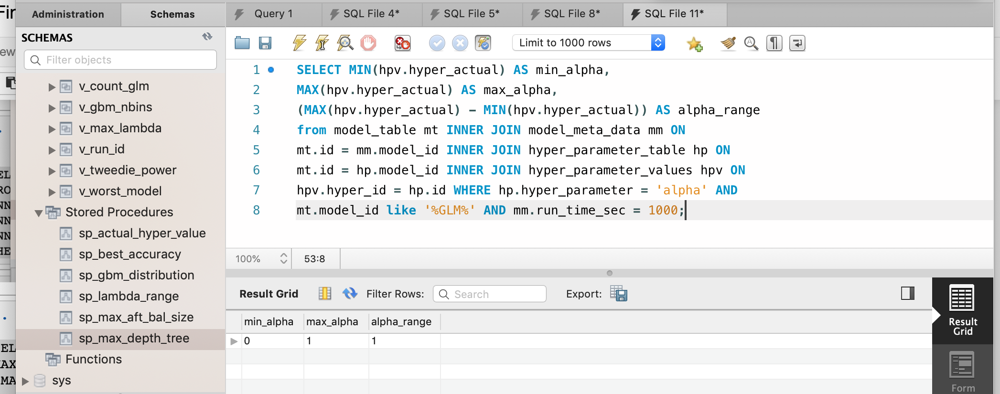

5. Which models hyperparameter has the tweedie_link_power has 1.0.

SELECT mt.model_id,mm.run_id,mm.system_date,mm.run_time_sec FROM model_table mt
INNER JOIN model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp
on mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
WHERE  hp.hyper_parameter = 'tweedie_link_power' AND hpv.hyper_actual = 1.0;

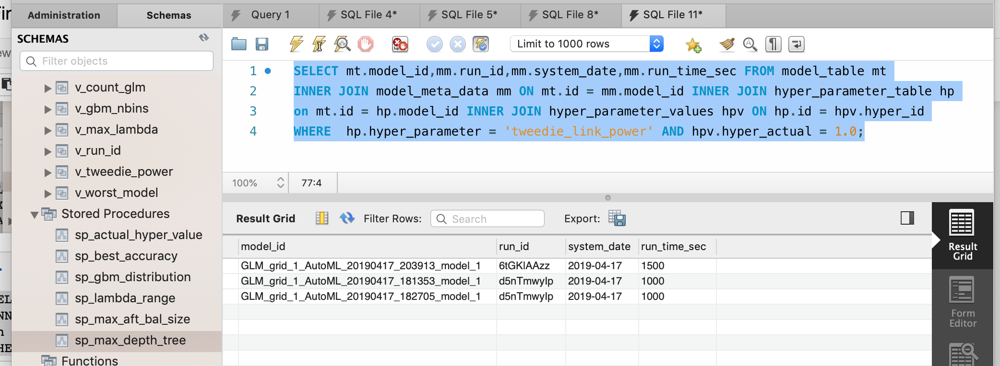

INDEXES: 

1.  select mt.model_id,mm.run_time_sec,mm.run_id from model_table mt inner join 
    model_meta_data mm ON mt.id = mm.model_id where system_date = '2019/04/17';

    create index ind_1 on model_meta_data(run_time_sec);

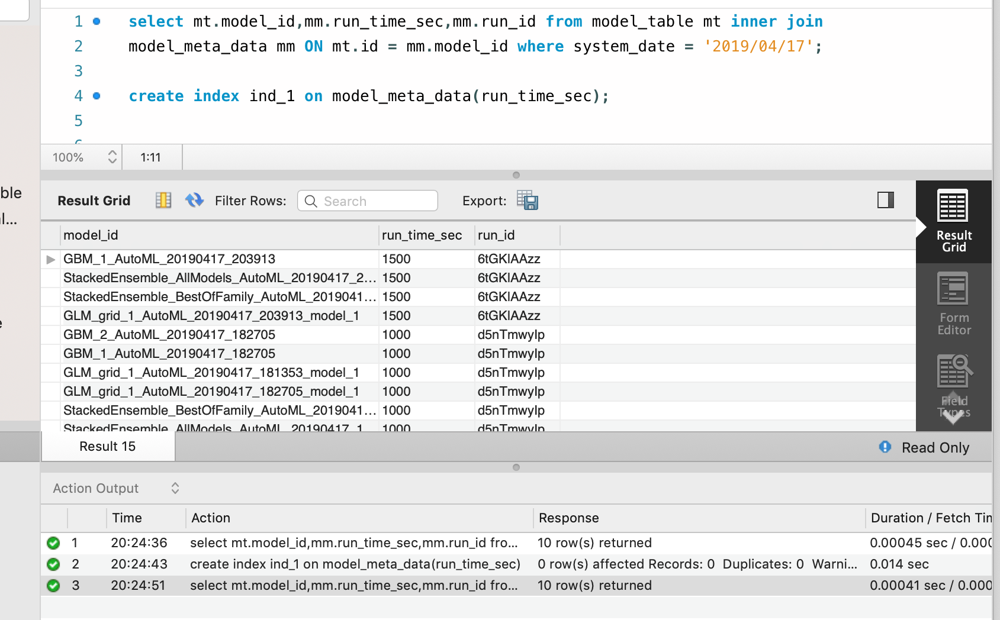

2. 

   SELECT mt.model_id,(SELECT AVG(rmse) from model_metrics) as best_accuracy 
   FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
   INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
   INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
   INNER JOIN model_metrics mm ON mm.model_id = mt.id LIMIT 1; 
 
   create index ind_2 on model_metrics(rmse);

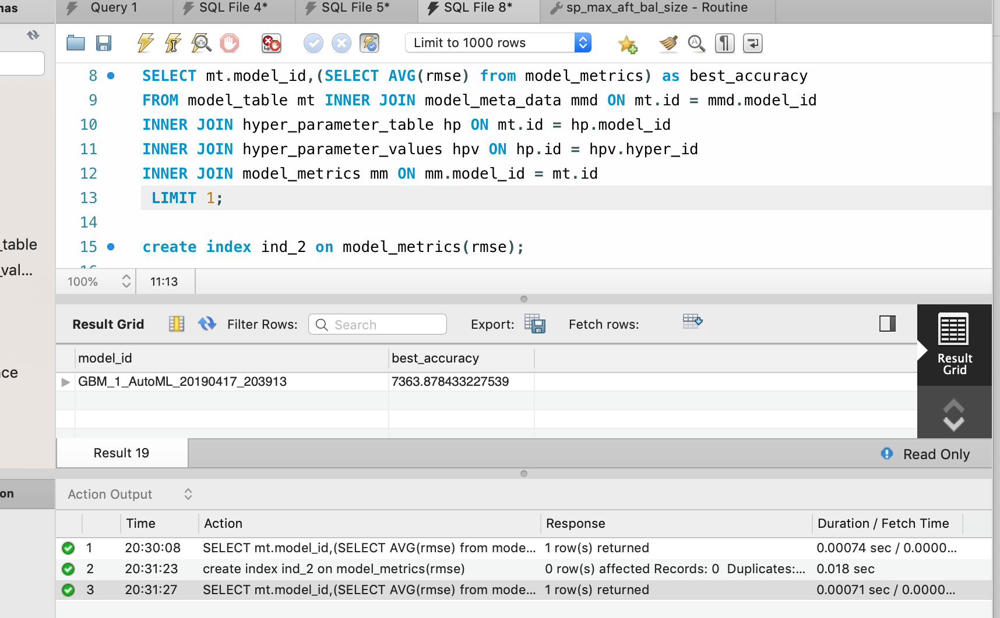

3. select mt.model_id,mm.run_id,mm.system_date,mm.run_time_sec from model_table mt
   INNER JOIN model_meta_data mm on mt.id = mm.model_id INNER JOIN hyper_parameter_table hp
   on mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
   WHERE  hp.hyper_parameter = 'tweedie_link_power' AND hpv.hyper_actual = 1.0;

   create index ind_3 on model_meta_data(run_id);



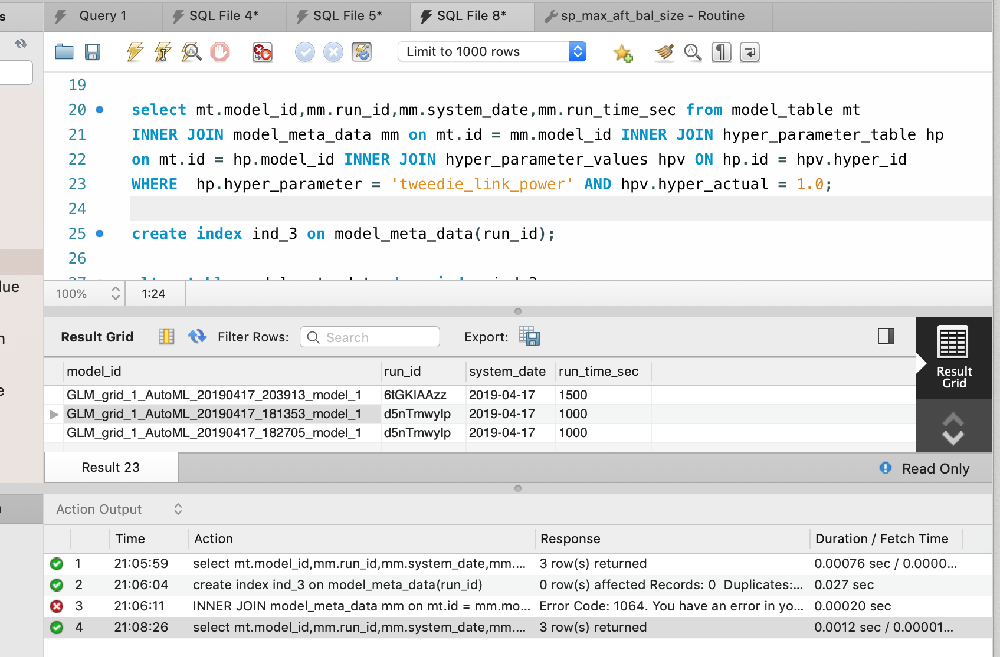

4. select mt.model_id, mm.run_time_sec, hp.hyper_parameter,
   hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
   mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
   mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
   hpv.hyper_id = hp.id WHERE  mt.model_id like '%GLM%' and 
   hpv.hyper_actual = (select MAX(hyper_actual) 
   from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
   on hpv.hyper_id = hp.id where hp.hyper_parameter = 'lambda');

   create index ind_4 on hyper_parameter_values(hyper_actual);


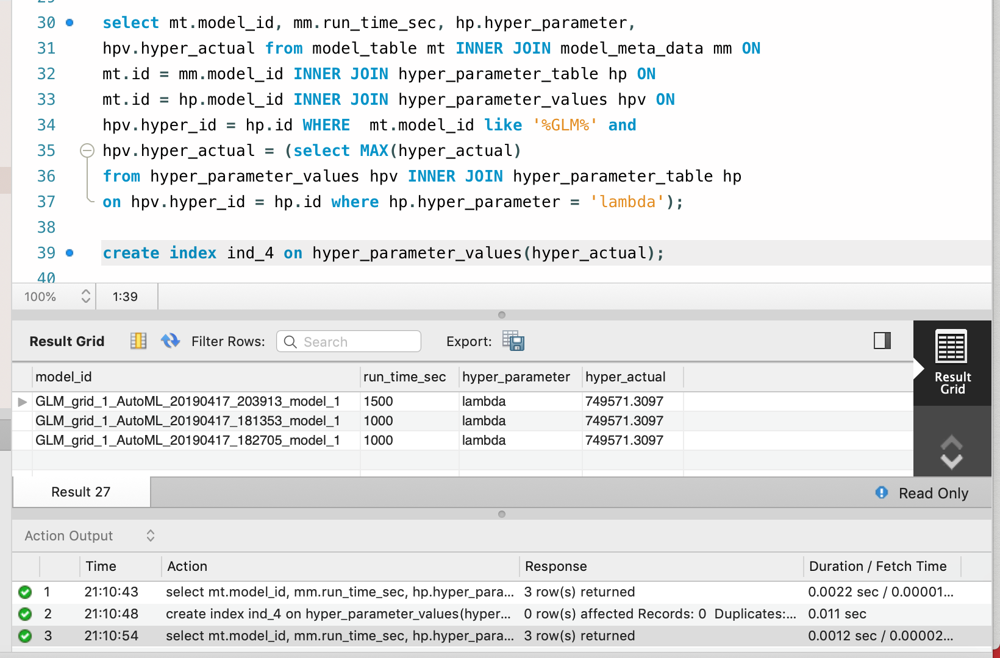

5. select mt.model_id,mm.run_time_sec,hpv.hyper_actual,hpv.hyper_default from model_table mt inner join 
   model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
   mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
   WHERE hp.hyper_parameter = "max_after_balance_size";

   create index ind_5 on hyper_parameter_values(hyper_default);


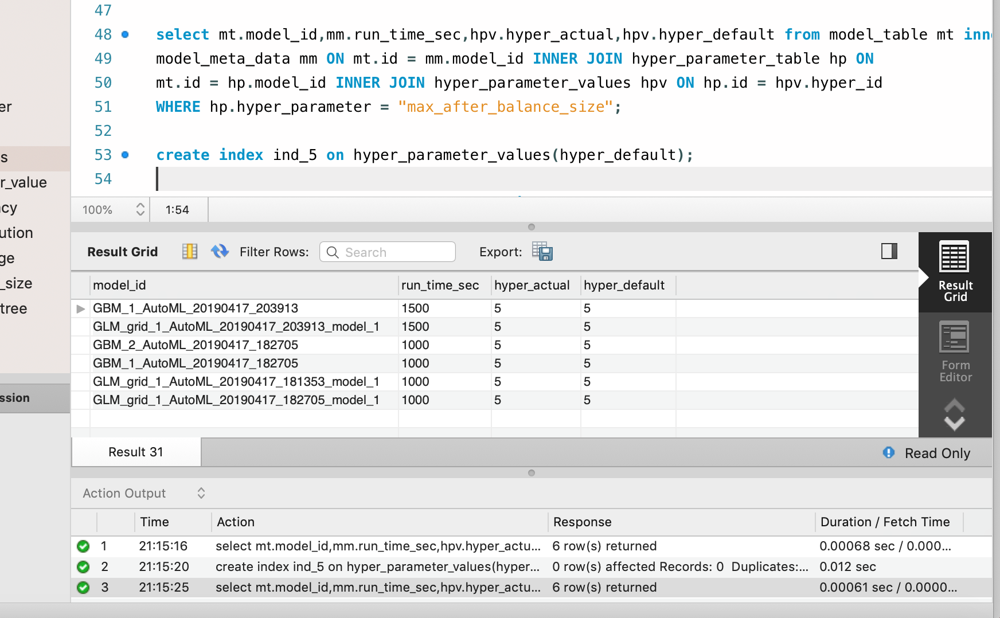

6. select mt.model_id, mm.run_time_sec, hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('seed','standardize','max_iterations') AND 
mt.model_id like '%GLM%';

create index ind_6 on hyper_parameter_table(hyper_parameter);


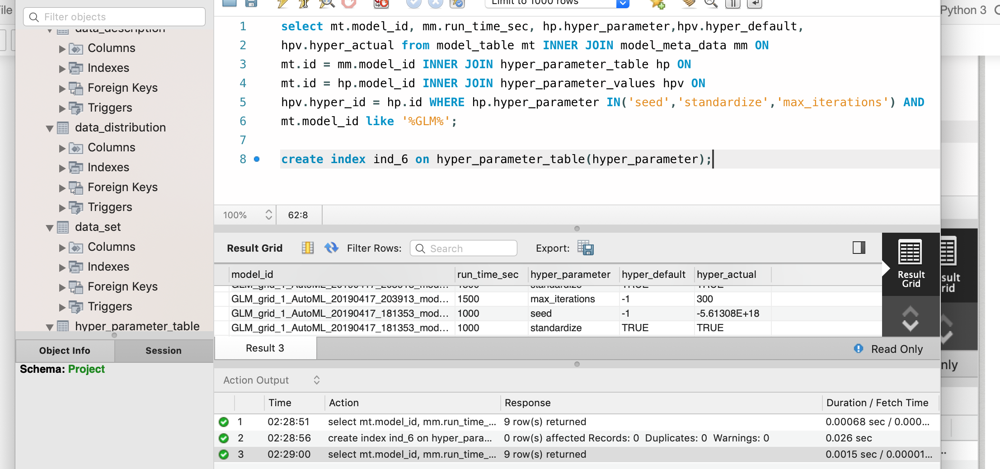

7.select mt.model_id,mm.run_time_sec,mm.run_id from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id where system_date = '2019/04/22';

create index ind_7 on model_table(model_id);

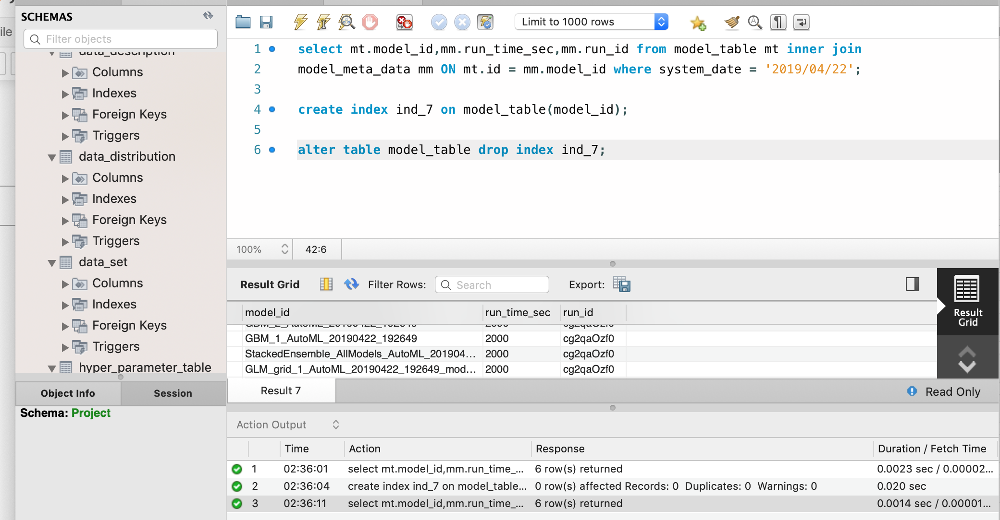

8.select mt.model_id, mm.run_time_sec,mm.system_date, hp.hyper_parameter,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE  mt.model_id like '%GLM%' and 
hpv.hyper_actual = (select MAX(hyper_actual) 
from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
on hpv.hyper_id = hp.id where hp.hyper_parameter = 'aplha');

create index ind_8 on model_meta_data(system_date);

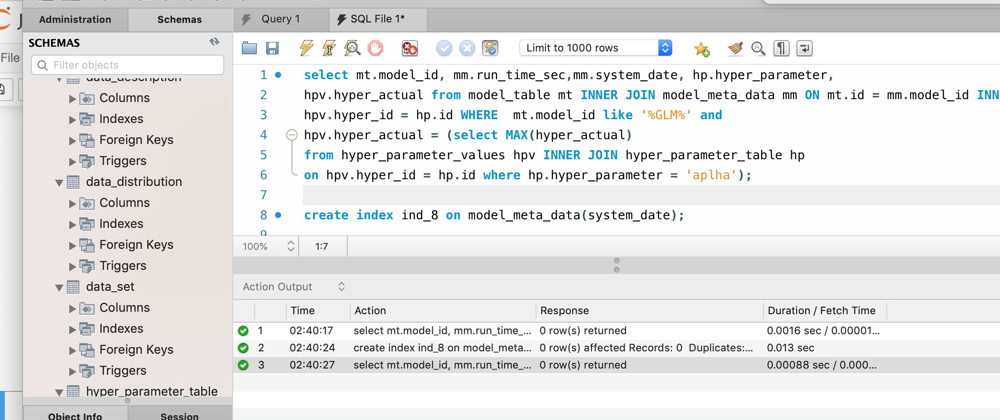

9.SELECT mt.model_id,mmd.run_time_sec,mm.mean_residual_deviance
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id;

create index ind_9 on model_metrics(mean_residual_deviance);

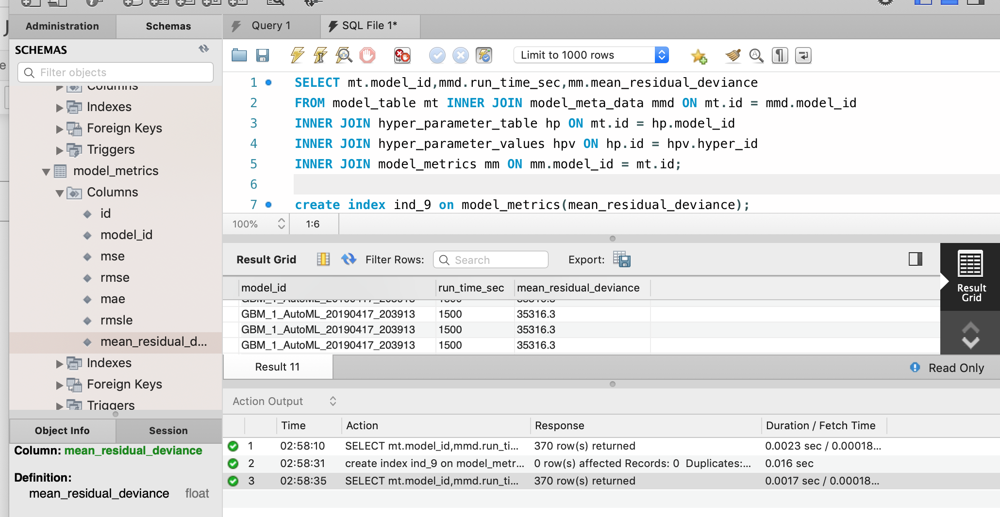

10.select mt.model_id, mm.run_time_sec,mm.start_time,mm.end_time,hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('stopping_rounds','stopping_metric','
stopping_tolerance') AND mt.model_id like '%GBM%'; 

create index ind_10 on model_meta_data(end_time);

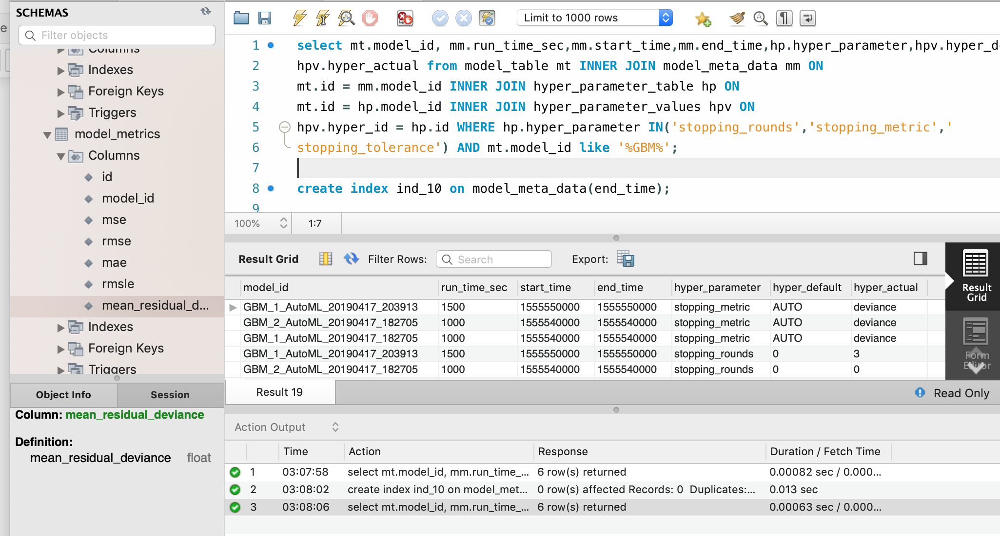

USE CASES(Ananya)

1. List of all models that was run on a particular run id

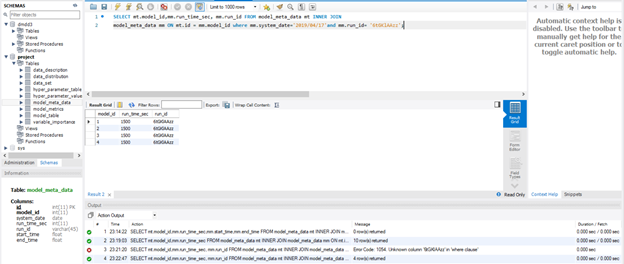

2.Error efficiency of run=1000

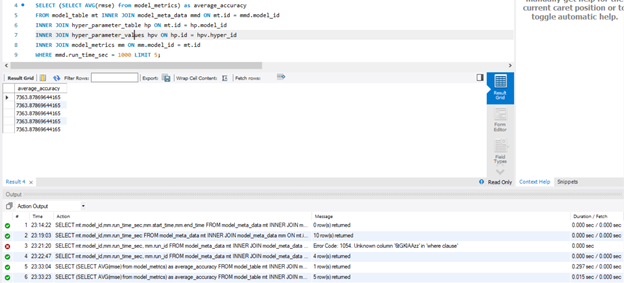

3.List of all the hyperparameter and their actual value for a particular model

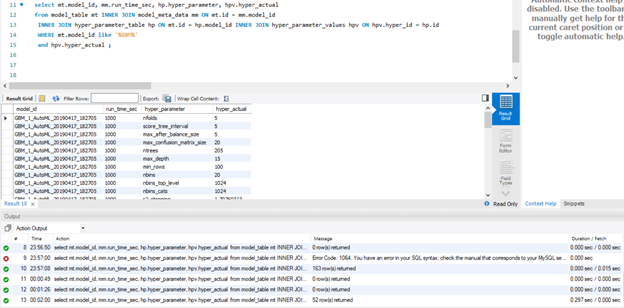

4.List of hyperparameter , runtime and their values of a particular model

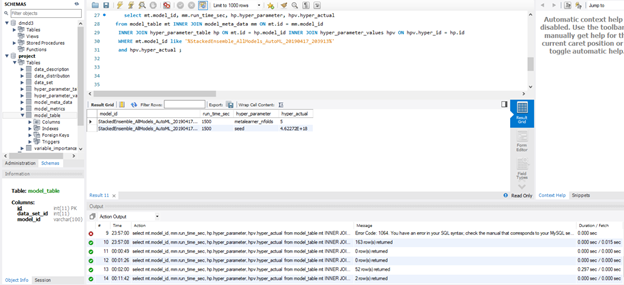

5. List the runtime of StackedEnsemble_AllModels_AutoML_20190417_203913

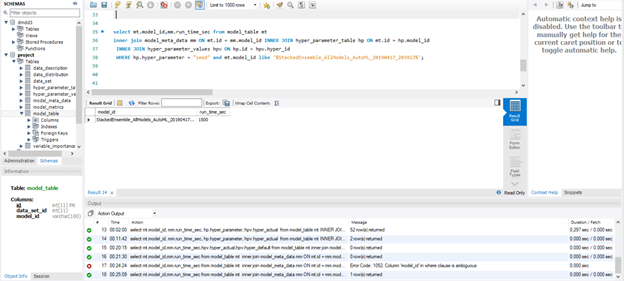

MIT License:

CitationsCopyright (c) [year] [fullname]

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

Citations :

http://docs.h2o.ai/h2o/latest-stable/h2o-docs/data-science/algo-params/ntrees.html

http://docs.h2o.ai/h2o/latest-stable/h2o-docs/data-science/algo-params/ntrees.html

https://wiki.easyvista.com/xwiki/bin/view/Documentation/SQL+rules

https://www.techonthenet.com/sql/indexes.php

https://stackoverflow.com/questions/14606900/mysql-create-a-simple-function

https://www.techonthenet.com/mysql/functions/index.php

Contributions :

Keerthana Siva has worked on the data to create 5 stored procedures, indexes and use cases, and has also worked on 2 views and functions. She has created the ER diagram and also explained how it worked. Her contributions include, insertion and creation of her part of the physical database. She has also contributed for report writing.

Ashrith Pradeep has worked on the data to create 5 stored procedures, indexes and use cases, and has also worked on 2 views and functions. He has created the conceptual diagram and also explained how it worked. His contributions include, insertion and creation of his part of the physical database. He has also contributed for report writing.

Ananya has worked on the data to create 5 stored procedures, indexes and use cases, and has also worked on 2 views and functions. Her contributions include, insertion and creation of her part of the physical database. She has worked on writing the portfolio for this project. 




Conclusion :

This project has taught us how to effectively create a physical database using SQL. We also learnt how to create stored procedure, views, functions and indexes. improving the performance of queries has been implemented using indexes in this project. We have also learnt how to collaborate with the data generated by H2O and use the csv data to make a physical database. Diagramatic representaion of relationships using ER diagram and conceptual schema has also been very helpful for the understanding of the data easily. 